In [1]:
import numpy as np
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import sys
#import cartopy.crs as crs
#import cartopy.feature as cfeature
import json
!{sys.executable} -m pip install PyAthena
import plotly
from pyathena import connect
import pandas as pd

from pyathena.async_cursor import AsyncCursor
import boto3

In [2]:
def q2df(q):
    cursor = connect(s3_staging_dir='s3://esdis-ems-athena', region_name='us-west-2', cursor_class=AsyncCursor).cursor(max_workers=2)
    query_id, future = cursor.execute(q)
    print (query_id, future)
#i=0
#for row in cursor:
#    if i==0:
#        print(row)
#    i+=1
#pd.options.display.float_format = '{:,.4f}'.format
#df = pd.read_sql(q, conn)
#df
    result_set = future.result()
    print(result_set.state)
#    print(result_set.state_change_reason)
#    print(result_set.completion_date_time)
#    print(result_set.submission_date_time)
#    print('Data Scanned Bytes:', result_set.data_scanned_in_bytes)
#    print(result_set.engine_execution_time_in_millis)
#    print(result_set.query_queue_time_in_millis)
    print('Total Execution Time (ms):', result_set.total_execution_time_in_millis)
#    print(result_set.query_planning_time_in_millis)
#    print(result_set.service_processing_time_in_millis)
#    print('Output location:', result_set.output_location)
#    print(result_set.description)


    s3_client = boto3.client('s3')

    obj=result_set.output_location[result_set.output_location.rfind('/')+1:]
    print(obj)

    s3_client.download_file('esdis-ems-athena', obj, '/home/ec2-user/myOut.csv')

    df=pd.read_csv('/home/ec2-user/myOut.csv')  
    return df    

In [3]:
# Climcaps level 2 products where modeled to an Athena table (CLIMCAPS)
# The CLIMCAPS athena table is partitioned by satellite. So all climcaps l2 product 
# from all satellites can be queried toghether or separately by including or excluding
# a particular satellite from the query.
#
# Each longitude/latidue/observation time "pixel" is represented as a row in the climcaps table.
# 3 dimensional arrays (representing altitude) are represented as arrays of records (structures) 
# 4 dimensional arrays are represented by 2d arrays for each "pixel".




q="""
select *
from 
climcaps_work_area.hurricane_ida
limit 100
"""
df_h_path=q2df(q)
df_h_path

59b5bff6-4c1c-422f-a06a-301f29cdead6 <Future at 0x7fe60380ef60 state=running>
SUCCEEDED
Total Execution Time (ms): 874
59b5bff6-4c1c-422f-a06a-301f29cdead6.csv


,obs_date_time,lat,lon,wspd,pres,stormtype,category
0,2021-08-26 15:00:00.000,16.9,-79.2,35 mph,1005 mb,Tropical Depression,--
1,2021-08-26 18:00:00.000,17.5,-79.5,35 mph,1005 mb,Tropical Depression,--
2,2021-08-26 21:00:00.000,18.0,-79.8,35 mph,1006 mb,Tropical Depression,--
3,2021-08-26 21:20:00.000,18.0,-79.8,40 mph,1006 mb,Tropical Storm,--
4,2021-08-27 00:00:00.000,18.0,-80.1,40 mph,1006 mb,Tropical Storm,--
...,...,...,...,...,...,...,...
59,2021-09-01 09:00:00.000,37.3,-82.5,30 mph,1000 mb,Tropical Depression,--
60,2021-09-01 15:00:00.000,38.3,-80.2,30 mph,1000 mb,Post-Tropical Cyclone,--
61,2021-09-01 21:00:00.000,39.7,-77.0,35 mph,999 mb,Post-Tropical Cyclone,--
62,2021-09-02 03:00:00.000,40.5,-74.3,40 mph,998 mb,Post-Tropical Cyclone,--


In [4]:
q="""
select 
 t1.time_base,
 t1.avg_sst "S Carrib",
 t2.avg_sst "N Carrib",
 t3.avg_sst "Ida Track (1000km)",
 t4.wtmp_k  "Buoy wtmp (1000km)"
from (
select
 date_format(time_base, '%Y-%m-%d %H:%i') time_base,
 'S Carrib' region,
 avg(sea_surface_temperature) avg_sst
from
 sci.abi_g16_star_l2p_v2_70
where
 time_base >= timestamp '2021-08-20'
 and longitude between -89.0  and -73.0
 and latitude between 14.0 and 22.0
group by
 time_base,2 ) t1,
(select
 date_format(time_base, '%Y-%m-%d %H:%i') time_base,
 'N Carrib' region,
 avg(sea_surface_temperature) avg_sst
from
 sci.abi_g16_star_l2p_v2_70
where
 time_base >= timestamp '2021-08-20'
 and longitude between -97.0  and -82.0
 and latitude between 20.0 and 31.0
group by
 time_base,2
) t2,
(
select 
 date_format(time_base, '%Y-%m-%d %H:%i') time_base,
 'Ida Track' region,
 avg(sea_surface_temperature) avg_sst
from
 sci.abi_g16_star_l2p_v2_70 s,
 climcaps_work_area.hurricane_ida c
where
 s.time_base >= timestamp '2021-08-20'
 and s.longitude between -97.0  and -73.0
 and s.latitude between 14.0 and 31.0
 and s.latitude between c.lat - 5.0 and c.lat + 5.0
 and s.longitude between c.lon - 5.0 and c.lon + 5.0
 and time_base between obs_date_time - interval '25' minute and obs_date_time + interval '25' minute
group by
 time_base,2
) t3,
(
select 
 date_format(obstime, '%Y-%m-%d %H:00') time_base,
 avg(wtmp + 273.15) wtmp_k
from
 environmental_datasets.ocean_bouy_nbdc b,
 climcaps_work_area.hurricane_ida h
where
 obstime >= timestamp '2021-08-20'
 and b.longitude between -97.0  and -73.0
 and b.latitude between 14.0 and 31.0
 and b.longitude between h.lon - 5.0 and h.lon + 5.0
 and b.latitude  between h.lat - 5.0 and h.lat  + 5.0
 and b.obstime between h.obs_date_time - interval '15' minute and h.obs_date_time + interval '15' minute
group by 1
order by 1
) t4
where t1.time_base = t2.time_base
 and t1.time_base = t3.time_base
 and t1.time_base = t4.time_base
order by
 1
"""
df=q2df(q)
df

ce04eb8e-6a7f-4549-b16c-174af5fffdc9 <Future at 0x7fe602c51128 state=running>
SUCCEEDED
Total Execution Time (ms): 15475
ce04eb8e-6a7f-4549-b16c-174af5fffdc9.csv


,time_base,S Carrib,N Carrib,Ida Track (1000km),Buoy wtmp (1000km)
0,2021-08-26 15:00,302.17184,302.60840,302.12820,301.600000
1,2021-08-26 18:00,302.47446,302.74405,302.52246,301.650000
2,2021-08-26 21:00,302.58322,302.71997,302.66037,301.750000
3,2021-08-27 00:00,302.33414,302.51483,302.48724,302.750000
4,2021-08-27 03:00,302.13025,302.45212,302.32290,302.650000
5,2021-08-27 06:00,302.03915,302.38340,302.35010,302.650000
6,2021-08-27 09:00,301.99870,302.40042,302.23310,302.604545
7,2021-08-27 12:00,301.91516,302.28757,302.24387,302.100000
8,2021-08-27 15:00,302.08127,302.44815,302.38370,302.356818
9,2021-08-27 17:00,302.25340,302.61713,302.52795,302.966092


In [5]:
import plotly.express as px

fig = px.line(df, x='time_base', y=df.columns)
#fig.show()
fig.write_html("carrib_sst_time_series" + ".html")

In [6]:
# h2o >= 1.00e26 ~ 7.0 degrees of storm location
q="""
select distinct
 c.sat_name_part,
 c.obs_date_part,
 c.lon, 
 c.lat, 
 asc_flag,
 date_parse(cast(c.obs_time_utc[1] as varchar) ||'-'|| cast(c.obs_time_utc[2] as varchar) ||'-'|| cast(c.obs_time_utc[3] as varchar) ||'T'|| cast(c.obs_time_utc[4] as varchar) ||':'|| cast(c.obs_time_utc[5] as varchar), '%Y-%c-%eT%k:%i'),
 0.0 - apv.air_pres_lay air_pres_lay,
 apv.h2o_vap_mol_lay 
from 
sci.climcaps c cross join unnest (c.air_pres_lay_vars) t(apv),
climcaps_work_area.hurricane_ida h
where
 c.lon between h.lon - 8.5 and h.lon + 8.5
 and c.lat between h.lat - 8.5 and h.lat + 8.5
 and date_parse(cast(c.obs_time_utc[1] as varchar) ||'-'|| cast(c.obs_time_utc[2] as varchar) ||'-'|| cast(c.obs_time_utc[3] as varchar) ||'T'|| cast(c.obs_time_utc[4] as varchar) ||':'|| cast(c.obs_time_utc[5] as varchar), '%Y-%c-%eT%k:%i')
 between h.obs_date_time - interval '5' hour and h.obs_date_time + interval '5' hour
 and apv.h2o_vap_mol_lay >= 1.00e26
order by
 c.obs_date_part, asc_flag, c.sat_name_part, c.lon, 0.0 - apv.air_pres_lay
"""
df=q2df(q)


3b4a1f39-2027-4a82-a70a-0f783a06862d <Future at 0x7fe60286e4e0 state=running>
SUCCEEDED
Total Execution Time (ms): 20689
3b4a1f39-2027-4a82-a70a-0f783a06862d.csv


In [7]:
df

,sat_name_part,obs_date_part,lon,lat,asc_flag,_col5,air_pres_lay,h2o_vap_mol_lay
0,aqua,2021-08-26,-84.56826,26.341785,1,2021-08-26 18:23:00.000,-99991.000000,1.588418e+26
1,aqua,2021-08-26,-84.56826,26.341785,1,2021-08-26 18:23:00.000,-97223.203125,1.547395e+26
2,aqua,2021-08-26,-84.56826,26.341785,1,2021-08-26 18:23:00.000,-94496.000000,1.507354e+26
3,aqua,2021-08-26,-84.56826,26.341785,1,2021-08-26 18:23:00.000,-91809.796875,1.403944e+26
4,aqua,2021-08-26,-84.56826,26.341785,1,2021-08-26 18:23:00.000,-89164.601562,1.231098e+26
...,...,...,...,...,...,...,...,...
93947,n20,2021-08-31,-77.72350,37.155342,1,2021-08-31 18:00:00.000,-94496.000000,1.256799e+26
93948,n20,2021-08-31,-77.72350,37.155342,1,2021-08-31 18:00:00.000,-91809.796875,1.238976e+26
93949,n20,2021-08-31,-77.72350,37.155342,1,2021-08-31 18:00:00.000,-89164.601562,1.218947e+26
93950,n20,2021-08-31,-77.72350,37.155342,1,2021-08-31 18:00:00.000,-86560.796875,1.176522e+26


In [8]:
import plotly.express as px

df['frame']=df['sat_name_part'] + '_' + df['asc_flag'].astype(str) + '_' + df['obs_date_part']
fig=px.scatter_3d(df, 
           x="lon", 
           y="lat",
           z='air_pres_lay',
           animation_frame="frame", 
           range_color=[min(df['h2o_vap_mol_lay']), max(df['h2o_vap_mol_lay'])],
           color="h2o_vap_mol_lay",
                  color_continuous_scale='jet'
          )
fig.write_html("climcaps_ida_h2o_vap_mol_lay" + ".html")

In [9]:
# Deviations from mean by observation and layer

q="""
with ida_avg as (
select
 obs_date_part,
 sat_name_part,
 asc_flag,
 air_pres_lay,
 avg(h2o_vap_mol_lay) avg_h2o_vap_mol_lay
from (
select
 distinct
 c.sat_name_part,
 c.obs_date_part,
 asc_flag,
 c.lon,
 c.lat,
 0.0 - apv.air_pres_lay air_pres_lay,
 apv.h2o_vap_mol_lay 
from 
sci.climcaps c cross join unnest (c.air_pres_lay_vars) t(apv),
climcaps_work_area.hurricane_ida h
where
 c.lon between h.lon - 8.5 and h.lon + 8.5
 and c.lat between h.lat - 8.5 and h.lat + 8.5
 and date_parse(cast(c.obs_time_utc[1] as varchar) ||'-'|| cast(c.obs_time_utc[2] as varchar) ||'-'|| cast(c.obs_time_utc[3] as varchar) ||'T'|| cast(c.obs_time_utc[4] as varchar) ||':'|| cast(c.obs_time_utc[5] as varchar), '%Y-%c-%eT%k:%i')
 between h.obs_date_time - interval '3' hour and h.obs_date_time + interval '3' hour
order by
 c.obs_date_part, asc_flag, c.sat_name_part, c.lon
) t1
group by 
  obs_date_part,
 sat_name_part,
 asc_flag,
 air_pres_lay
order by 
 1,2,3,4
),
t2 as (
select
 distinct
 c.sat_name_part,
 c.obs_date_part,
 asc_flag,
 c.lon,
 c.lat,
 0.0 - apv.air_pres_lay air_pres_lay,
 apv.h2o_vap_mol_lay 
from 
sci.climcaps c cross join unnest (c.air_pres_lay_vars) t(apv),
climcaps_work_area.hurricane_ida h
where
 c.lon between h.lon - 8.5 and h.lon + 8.5
 and c.lat between h.lat - 8.5 and h.lat + 8.5
 and date_parse(cast(c.obs_time_utc[1] as varchar) ||'-'|| cast(c.obs_time_utc[2] as varchar) ||'-'|| cast(c.obs_time_utc[3] as varchar) ||'T'|| cast(c.obs_time_utc[4] as varchar) ||':'|| cast(c.obs_time_utc[5] as varchar), '%Y-%c-%eT%k:%i')
 between h.obs_date_time - interval '3' hour and h.obs_date_time + interval '3' hour
order by
 c.obs_date_part, asc_flag, c.sat_name_part, c.lon
)
select 
 t2.obs_date_part,
 t2.sat_name_part,
 t2.asc_flag,
 t2.air_pres_lay,
 t2.lon,
 t2.lat,
 (h2o_vap_mol_lay - avg_h2o_vap_mol_lay ) as deviation_h2o_vap_mol_lay
from 
ida_avg,
t2
where
 t2.sat_name_part = ida_avg.sat_name_part
 and t2.obs_date_part = ida_avg.obs_date_part
 and t2.asc_flag      = ida_avg.asc_flag
 and t2.air_pres_lay  = ida_avg.air_pres_lay
 and abs ((h2o_vap_mol_lay - avg_h2o_vap_mol_lay)) > 0.1e26
order by
 t2.obs_date_part,
 t2.asc_flag,
 t2.sat_name_part,
 t2.air_pres_lay
"""
df=q2df(q)

0ae7c05b-bb0b-456a-a996-c61bdc9ddf52 <Future at 0x7fe602b20400 state=running>
SUCCEEDED
Total Execution Time (ms): 54193
0ae7c05b-bb0b-456a-a996-c61bdc9ddf52.csv


In [10]:
df

,obs_date_part,sat_name_part,asc_flag,air_pres_lay,lon,lat,deviation_h2o_vap_mol_lay
0,2021-08-26,aqua,1,-86560.796875,-71.011110,11.182248,4.076928e+25
1,2021-08-26,aqua,1,-86560.796875,-77.175870,25.722902,-1.885362e+25
2,2021-08-26,aqua,1,-86560.796875,-71.017136,24.619810,1.710899e+25
3,2021-08-26,aqua,1,-86560.796875,-77.163180,22.213932,-1.682483e+25
4,2021-08-26,aqua,1,-86560.796875,-71.035446,15.170721,-1.446903e+25
...,...,...,...,...,...,...,...
114479,2021-08-31,n20,1,-39909.699219,-84.588470,29.662685,1.078563e+25
114480,2021-08-31,n20,1,-39909.699219,-89.151215,27.905859,1.079845e+25
114481,2021-08-31,n20,1,-38272.300781,-78.871590,36.927338,1.002072e+25
114482,2021-08-31,n20,1,-38272.300781,-79.037170,37.389282,1.058450e+25


In [11]:
import plotly.express as px

df['frame']=df['sat_name_part'] + '_' + df['asc_flag'].astype(str) + '_' + df['obs_date_part']
fig=px.scatter_3d(df, 
           x="lon", 
           y="lat",
           z='air_pres_lay',
           animation_frame="frame", 
           range_color=[min(df['deviation_h2o_vap_mol_lay']), max(df['deviation_h2o_vap_mol_lay'])],
           color="deviation_h2o_vap_mol_lay",
            color_continuous_scale='jet'
          )
fig.write_html("climcaps_ida_diff_by_scene" + ".html")

In [12]:
# Deviations from mean layers (all scenes averaged together)
q="""
with ida_avg as (
select
 air_pres_lay,
 avg(h2o_vap_mol_lay) avg_h2o_vap_mol_lay
from (
select
 distinct
 c.sat_name_part,
 c.obs_date_part,
 asc_flag,
 c.lon,
 c.lat,
 0.0 - apv.air_pres_lay air_pres_lay,
 apv.h2o_vap_mol_lay 
from 
sci.climcaps c cross join unnest (c.air_pres_lay_vars) t(apv),
climcaps_work_area.hurricane_ida h
where
 c.lon between h.lon - 8.5 and h.lon + 8.5
 and c.lat between h.lat - 8.5 and h.lat + 8.5
 and date_parse(cast(c.obs_time_utc[1] as varchar) ||'-'|| cast(c.obs_time_utc[2] as varchar) ||'-'|| cast(c.obs_time_utc[3] as varchar) ||'T'|| cast(c.obs_time_utc[4] as varchar) ||':'|| cast(c.obs_time_utc[5] as varchar), '%Y-%c-%eT%k:%i')
 between h.obs_date_time - interval '3' hour and h.obs_date_time + interval '3' hour
 and apv.h2o_vap_mol_lay_qc in ('0', '1')
order by
 c.obs_date_part, asc_flag, c.sat_name_part, c.lon
) t1
group by 
  1
order by 
 1
)
select 
 t2.obs_date_part,
 t2.sat_name_part,
 t2.asc_flag,
 t2.air_pres_lay,
 t2.lon,
 t2.lat,
 (h2o_vap_mol_lay - avg_h2o_vap_mol_lay ) as deviation_h2o_vap_mol_lay
from 
ida_avg,
(
select
 distinct
 c.sat_name_part,
 c.obs_date_part,
 asc_flag,
 c.lon,
 c.lat,
 0.0 - apv.air_pres_lay air_pres_lay,
 apv.h2o_vap_mol_lay 
from 
sci.climcaps c cross join unnest (c.air_pres_lay_vars) t(apv),
climcaps_work_area.hurricane_ida h
where
 c.lon between h.lon - 8.5 and h.lon + 8.5
 and c.lat between h.lat - 8.5 and h.lat + 8.5
 and date_parse(cast(c.obs_time_utc[1] as varchar) ||'-'|| cast(c.obs_time_utc[2] as varchar) ||'-'|| cast(c.obs_time_utc[3] as varchar) ||'T'|| cast(c.obs_time_utc[4] as varchar) ||':'|| cast(c.obs_time_utc[5] as varchar), '%Y-%c-%eT%k:%i')
 between h.obs_date_time - interval '3' hour and h.obs_date_time + interval '3' hour
order by
 c.obs_date_part, asc_flag, c.sat_name_part, c.lon
) t2
where
 t2.air_pres_lay = ida_avg.air_pres_lay
 and abs ((h2o_vap_mol_lay - avg_h2o_vap_mol_lay)) > 0.1e26
order by
 t2.obs_date_part,
 t2.asc_flag,
 t2.sat_name_part,
 t2.air_pres_lay
"""
df=q2df(q)

8e2c211b-98ab-4a6e-9049-64374611088b <Future at 0x7fe629ee7e48 state=running>
SUCCEEDED
Total Execution Time (ms): 47748
8e2c211b-98ab-4a6e-9049-64374611088b.csv


In [40]:
df

,obs_date_part,sat_name_part,asc_flag,air_pres_lay,lon,lat,deviation_h2o_vap_mol_lay
0,2021-08-26,aqua,1,-99991.000000,-72.447800,12.460743,1.668082e+25
1,2021-08-26,aqua,1,-99991.000000,-72.474760,17.953010,-1.255399e+25
2,2021-08-26,aqua,1,-99991.000000,-72.495640,21.940010,-2.021206e+25
3,2021-08-26,aqua,1,-99991.000000,-72.496544,19.945920,-1.441339e+25
4,2021-08-26,aqua,1,-99991.000000,-72.550270,9.443768,-1.978168e+25
...,...,...,...,...,...,...,...
158943,2021-08-31,n20,1,-41588.500000,-84.588470,29.662685,1.084798e+25
158944,2021-08-31,n20,1,-41588.500000,-83.958560,31.806623,1.179483e+25
158945,2021-08-31,n20,1,-41588.500000,-79.037170,37.389282,1.113304e+25
158946,2021-08-31,n20,1,-41588.500000,-78.871590,36.927338,1.066992e+25


In [41]:
import plotly.express as px

df['frame']=df['sat_name_part'] + '_' + df['asc_flag'].astype(str) + '_' + df['obs_date_part']
fig=px.scatter_3d(df, 
           x="lon", 
           y="lat",
           z='air_pres_lay',
           animation_frame="frame", 
           range_color=[min(df['deviation_h2o_vap_mol_lay']), max(df['deviation_h2o_vap_mol_lay'])],
           color="deviation_h2o_vap_mol_lay",
           color_continuous_scale='jet'
)
fig.write_html("climcaps_ida_diff" + ".html")

In [ ]:
q="""
select
 time_base,
 longitude,
 latitude, 
 sea_surface_temperature 
from 
 sci.abi_g16_star_l2p_v2_70 g
where 
 time_base in (timestamp '2021-08-29 17:00', 
 timestamp '2021-08-30 17:00', 
 timestamp '2021-08-31 17:00', 
 timestamp '2021-09-01 17:00')
 and g.longitude between -97. and -75.
 and g.latitude between 10.7 and 30.7
order by
 g.time_base, 2
"""
df_g16=q2df(q)
df_g16

1af90649-5d4a-433c-a079-e8eb8512cccf <Future at 0x7f467d605da0 state=running>


In [76]:
df_g16['size']=10

fig = px.scatter_mapbox(
    df_g16, 
    lat="latitude", 
    lon="longitude",
    mapbox_style="open-street-map",
    animation_frame = 'time_base', 
#    animation_group = 'obs_date_part',
    range_color=[min(g16_df['sea_surface_temperature']), max(g16_df['sea_surface_temperature'])],
    color="sea_surface_temperature", 
    size="size",
    color_continuous_scale='jet', 
    size_max=10, 
    hover_name='time_base',
    hover_data=[],
    title = 'SST Carribean (g16)')
fig.write_html('g16_sst_carrib.html')

In [48]:
q="""
select
 o.time_base,
 o.longitude,
 o.latitude,
 o.sea_surface_temperature,
 round( abs(sea_surface_temperature - mean_sst) / stdev_sst, 0) sigma,
 count_sst,
 o.sea_surface_temperature - mean_sst diff_from_mean
from 
 sci.abi_g16_star_l2p_v2_70 o,
 sci.stats_abi_g16_star_l2p_v2_70 s
where
 o.time_base between timestamp '2021-08-19 12:00' and timestamp '2021-09-02 12:00'
 and date_format(o.time_base, '%H') = '17'
 and o.longitude between -97. and -75.
 and o.latitude between 10.7 and 30.7
 and round(o.longitude, 1) = s.longitude
 and round(o.latitude, 1 ) = s.latitude
 and date_format(time_base, '%m') = s.obs_month
 and  round( abs(sea_surface_temperature - mean_sst) / stdev_sst, 0) > 4.0
order by
 1,2,3
"""
g16_df=q2df(q)

4b018c45-e96a-4af5-98f6-d0079ed04545 <Future at 0x7f467e7baf98 state=running>
SUCCEEDED
Total Execution Time (ms): 2974
4b018c45-e96a-4af5-98f6-d0079ed04545.csv


In [49]:
g16_df

,time_base,longitude,latitude,sea_surface_temperature,sigma,count_sst,diff_from_mean
0,2021-08-25 17:00:00.000,-96.98640,21.12072,300.91,5.0,277,-2.675263
1,2021-08-25 17:00:00.000,-86.43840,16.35660,307.10,5.0,116,3.957855
2,2021-08-25 17:00:00.000,-82.45692,15.93716,301.55,5.0,317,-1.545380
3,2021-08-25 17:00:00.000,-77.50768,21.74769,302.79,5.0,104,-3.071350
4,2021-08-27 17:00:00.000,-91.31030,12.06585,301.45,6.0,72,-2.141785
...,...,...,...,...,...,...,...
1897,2021-09-01 17:00:00.000,-77.37550,18.84156,301.80,5.0,382,-2.248352
1898,2021-09-01 17:00:00.000,-77.30043,18.95999,302.38,5.0,326,-1.644409
1899,2021-09-01 17:00:00.000,-77.30043,18.95999,302.38,5.0,326,-1.644409
1900,2021-09-01 17:00:00.000,-77.18268,18.82135,301.89,5.0,354,-2.193481


In [50]:
g16_df['size']=10

fig = px.scatter_mapbox(
    g16_df, 
    lat="latitude", 
    lon="longitude",
    mapbox_style="open-street-map",
    animation_frame = 'time_base', 
#    animation_group = 'obs_date_part', 
    range_color=[min(g16_df['diff_from_mean']), max(g16_df['diff_from_mean'])],

    color="diff_from_mean", 
    size="size",
    color_continuous_scale='jet', 
    size_max=10, 
    hover_name='time_base',
    hover_data=['sea_surface_temperature', 'sigma'],
    title = 'SST Carribean (g16)')
fig.write_html('g16_sst_carrib_sigma5.html')

In [223]:
q="""
select
 c2.obs_date_part,
 c2.sat_name_part,
 c2.asc_flag,
 c2.lon,
 c2.lat,
 avg(t.air_temp_avg - apv2.air_temp) air_temp_diff
from 
(select 
 c.obs_date_part,
 round(lon, 0) lon,
 round(lat, 0) lat,
 avg(  apv.air_temp) air_temp_avg,
 stddev(apv.air_temp) air_temp_stddev
from sci.climcaps c cross join unnest (c.air_pres_vars) t1(apv)
where 
 obs_date_part = '2021-08-25'
 and apv.air_temp_qc in ('0', '1')
 and lon between -90 and -70
 and lat between 15 and 35
 and apv.air_pres between 40000 and 70000
group by 1,2,3
order by 1,2,3
  ) t,
  sci.climcaps c2 cross join unnest (c2.air_pres_vars) t2(apv2)
where 
 c2.obs_date_part = t.obs_date_part
 and c2.lon between t.lon - 0.5 and t.lon + 0.5
 and c2.lat between t.lat - 0.5 and t.lat + 0.5
 and apv2.air_pres between 40000 and 70000
group by 1,2,3,4,5
order by
 1,2,3,4,5
"""
df_a=q2df(q)
df_a

2570f6f3-eca1-40f4-9add-52f75e246ea9 <Future at 0x7f041abb0630 state=running>


KeyboardInterrupt: 

In [125]:
import plotly.express as px

df_a['frame']=df_a['sat_name_part'] + '_' + df_a['asc_flag'].astype(str) + '_' + df_a['obs_date_part']
fig=px.scatter(df_a, 
           x="lon", 
           y="lat",
           animation_frame="frame", 
           color="air_temp_diff"
          )
fig.write_html("climcaps_anomaly_animation" + ".html")

In [ ]:
q="""
select
 c2.obs_date_part,
 c2.sat_name_part,
 c2.asc_flag,
 c2.lon,
 c2.lat,
 avg(t.air_temp_avg - apv2.air_temp) air_temp_diff
from 
(select 
 c.obs_date_part,
 round(c.lon, 0) lon,
 round(c.lat, 0) lat,
 avg(  apv.air_temp) air_temp_avg,
 stddev(apv.air_temp) air_temp_stddev
from sci.climcaps c cross join unnest (c.air_pres_vars) t1(apv)
where 
 obs_date_part between '2021-08-20' and '2021-08-30'
 and lon between -100 and -70
 and lat between 15 and 35
 and apv.air_temp_qc in ('0', '1')
 and apv.air_pres between 40000 and 70000
group by 1,2,3
order by 1,2,3
  ) t,
  sci.climcaps c2 cross join unnest (c2.air_pres_vars) t2(apv2)
where 
 c2.obs_date_part = t.obs_date_part
 and c2.lon between t.lon - 0.5 and t.lon + 0.5
 and c2.lat between t.lat - 0.5 and t.lat + 0.5
  and c2.lon between -100 and -70
 and c2.lat between 15 and 35
 and apv2.air_pres between 40000 and 70000
group by 1,2,3,4,5
order by
 1,2,3,4,5
"""
df_a=q2df(q)
df_a

In [ ]:
df_a

In [ ]:
df_a['frame']=df_a['sat_name_part'] + '_' + df_a['asc_flag'].astype(str) + '_' + df_a['obs_date_part']

fig=go.Figure()

fig = fig.add_trace(go.Scattermapbox(
    lon=df_a['lon'], 
    lat=df_a['lat'],
    mode='markers',
    marker=go.scattermapbox.Marker(
            size=8,
            color=df_a['air_temp_diff'],
            cmax=7.0,
            cmin=-7.0,
            colorscale='Jet'
    ),
    name='SST 5 Sigma Anomalies August 20-31, 2021',
    text=['diff: ' + str(round(df_a["air_temp_diff"][i],2)) + '<br>date time: ' + str(df_a["obs_date_part"][i]) for i, row in df_a.iterrows() ],
    hoverinfo='text'
    )
)

fig.update_layout(mapbox_style="open-street-map",  height=3000)
fig.update_layout(autosize=False, 
    width=2000, 
    height=1200,
    margin={"r":0,"t":0,"l":0,"b":0})
#fig.update_layout(
#    mapbox=dict(bearing=0, center=go.layout.mapbox.Center(lat=20, lon=-75),pitch=0,zoom=5)
#)
#fig.show("notebook")
fig.write_html("map_" + "climcaps_anomaly" + ".html")

In [ ]:
df_a['frame']=df_a['sat_name_part'] + '_' + df_a['asc_flag'].astype(str) + '_' + df_a['obs_date_part']
df_a['size']=1

In [ ]:
df_a['size']=10
fig = px.scatter_mapbox(
    df_a, 
    lat="lat", 
    lon="lon",
    mapbox_style="open-street-map",
    animation_frame = 'frame', 
    animation_group = 'obs_date_part', 
    color="air_temp_diff", 
    size="size",
    color_continuous_scale='jet', 
    size_max=10, 
    hover_name='obs_date_part',
    hover_data=['air_temp_diff', 'sat_name_part', 'obs_date_part'],
    title = 'TEst')
fig.show()
fig.write_html('x.html')

In [233]:
q="""
select t2.*, h_date, h_lon, h_lat, h_type
from 
(
select
 c2.obs_date_part,
 c2.sat_name_part,
 c2.asc_flag,
 c2.lon,
 c2.lat,
 avg(t.h2o_vap_tot_avg - h2o_vap_tot) air_temp_diff
from 
(select 
 c.obs_date_part,
 round(c.lon, 0) lon,
 round(c.lat, 0) lat,
 avg( h2o_vap_tot) h2o_vap_tot_avg,
 stddev(h2o_vap_tot) h2o_vap_tot_stddev
from sci.climcaps c 
where 
 obs_date_part between '2021-08-20' and '2021-08-30'
 and lon between -100 and -70
 and lat between 15 and 35
 and h2o_vap_tot_qc in ('0', '1')
group by 1,2,3
order by 1,2,3
  ) t,
  sci.climcaps c2 
where 
 c2.obs_date_part = t.obs_date_part
 and c2.lon between t.lon - 0.5 and t.lon + 0.5
 and c2.lat between t.lat - 0.5 and t.lat + 0.5
  and c2.lon between -100 and -70
 and c2.lat between 15 and 35
group by 1,2,3,4,5
order by
 1,3,2,4,5
) t2

LEFT OUTER JOIN 

( select date_format(obs_date_time, '%Y-%m-%d') h_date, avg(lon) h_lon, avg(lat) h_lat, min(stormType) h_type
from 
 climcaps_work_area.hurricane_ida
group by
 date_format(obs_date_time, '%Y-%m-%d')
 ) h
 ON t2.obs_date_part = h.h_date 
"""
df_a=q2df(q)
df_a

7ec817b0-be65-4acc-ae40-83ebbb2ce9f4 <Future at 0x7f04191d8748 state=running>
SUCCEEDED
None
2021-11-23 21:49:22.265000+00:00
2021-11-23 21:49:17.558000+00:00
Data Scanned Bytes: 106884100
4530
126
Total Execution Time (ms): 4707
945
51
Output location: s3://esdis-ems-athena/7ec817b0-be65-4acc-ae40-83ebbb2ce9f4.csv
[('obs_date_part', 'varchar', None, None, 2147483647, 0, 'UNKNOWN'), ('sat_name_part', 'varchar', None, None, 2147483647, 0, 'UNKNOWN'), ('asc_flag', 'varchar', None, None, 2147483647, 0, 'UNKNOWN'), ('lon', 'float', None, None, 17, 0, 'UNKNOWN'), ('lat', 'float', None, None, 17, 0, 'UNKNOWN'), ('air_temp_diff', 'float', None, None, 17, 0, 'UNKNOWN'), ('h_date', 'varchar', None, None, 2147483647, 0, 'UNKNOWN'), ('h_lon', 'float', None, None, 17, 0, 'UNKNOWN'), ('h_lat', 'float', None, None, 17, 0, 'UNKNOWN'), ('h_type', 'varchar', None, None, 2147483647, 0, 'UNKNOWN')]
7ec817b0-be65-4acc-ae40-83ebbb2ce9f4.csv


,obs_date_part,sat_name_part,asc_flag,lon,lat,air_temp_diff,h_date,h_lon,h_lat,h_type
0,2021-08-20,aqua,0,-99.999220,33.474120,-1.062443,NaN,NaN,NaN,NaN
1,2021-08-20,aqua,0,-99.973710,15.304074,-0.565342,NaN,NaN,NaN,NaN
2,2021-08-20,aqua,0,-99.948280,18.759312,0.234554,NaN,NaN,NaN,NaN
3,2021-08-20,aqua,0,-99.941260,22.700111,1.117386,NaN,NaN,NaN,NaN
4,2021-08-20,aqua,0,-99.922220,27.606575,1.988663,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
65373,2021-08-29,n20,1,-78.804650,26.605314,0.935078,2021-08-29,-89.605,28.54,Hurricane
65374,2021-08-29,n20,1,-78.779690,21.738796,-0.240643,2021-08-29,-89.605,28.54,Hurricane
65375,2021-08-29,n20,1,-78.765366,15.387696,1.953312,2021-08-29,-89.605,28.54,Hurricane
65376,2021-08-29,n20,1,-78.750496,17.347345,-0.049953,2021-08-29,-89.605,28.54,Hurricane


In [235]:
df_a['frame']=df_a['sat_name_part'] + '_' + df_a['asc_flag'].astype(str) + '_' + df_a['obs_date_part']
df_a['size']=1

In [248]:
df_a['size']=10
fig = px.scatter_mapbox(
    df_a, 
    lat="lat", 
    lon="lon",
    mapbox_style="open-street-map",
    animation_frame = 'frame', 
    animation_group = 'obs_date_part', 
    color="air_temp_diff", 
    size="size",
    color_continuous_scale='jet', 
    size_max=10, 
    hover_name='obs_date_part',
    hover_data=['air_temp_diff', 'sat_name_part', 'obs_date_part'],
    title = 'TEst')
fig.show()
fig.write_html('y.html')

In [3]:
def plot3d(df):
    fig = plt.figure(figsize=(18,15))
    ax = fig.add_subplot(projection='3d')
    xs = df['lon']
    ys = df['lat']
    zs = df['d']
    ax.scatter(xs, ys, zs, marker=1, c = df['v'], cmap = 'jet')

    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_zlabel('Presure')

    plt.show()
    return()


In [4]:
def plotly3d(my_df, name):
    import plotly.express as px
    fig = px.scatter_3d(my_df, x='lon', y='lat', z='d', color='v', symbol='sat', opacity=0.0, color_continuous_scale='BlueRed')
    fig.show("notebook")
    fig.write_html("climcaps_" + name + "h2o_3d_scatter" + ".html")
#    fig.show()
    return

array([[<AxesSubplot:title={'center':'lon'}>,
        <AxesSubplot:title={'center':'lat'}>],
       [<AxesSubplot:title={'center':'asc_flag'}>,
        <AxesSubplot:title={'center':'air_pres_lay'}>],
       [<AxesSubplot:title={'center':'h2o_vap_mol_lay'}>, <AxesSubplot:>]],
      dtype=object)

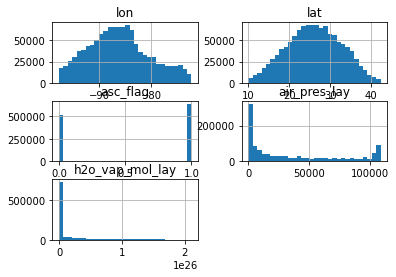

In [35]:
df.hist(bins=30)

In [1]:
# Break rows into individual scenes
# Scene is obs_date_part + asc_flag
myScene = ['','']
sceneRows=0
scene={
    'lon' : [],
    'lat' : [],
    'sat' : [],
    'd' : [],
    'v' : []
}

for i,r in df.iterrows():
    sceneRows+=1
    if myScene[0]=='':
        myScene[0]=r['obs_date_part']
        myScene[1]=r['asc_flag']
    if r['obs_date_part'] != myScene[0] or r['asc_flag'] != myScene[1]:
        print ('Scene:', myScene, 'Rows:', sceneRows)
        myScene[0]=r['obs_date_part']
        myScene[1]=r['asc_flag']
        plot3d(scene)
        plotly3d(scene, myScene[0]+'-'+str(myScene[1]))
        scene={
            'lon' : [],
            'lat' : [],
            'sat' : [],
            'd' : [],
            'v' : []
        }
    scene['lon'].append(r['lon'])   
    scene['lat'].append(r['lat'])   
    scene['sat'].append(r['sat_name_part'])   
    scene['d'].append(0 - r['air_pres_lay'])   
    scene['v'].append(r['h2o_vap_mol_lay'])   
        

# Last Scene
print ('Scene:', myScene, 'Rows:', sceneRows)

    
    

NameError: name 'df' is not defined

In [50]:
# Break rows into individual scenes
# Scene is obs_date_part + asc_flag
myScene = ['','', '']
sceneRows=0
scene={
    'lon' : [],
    'lat' : [],
    'sat' : [],
    'd' : [],
    'v' : []
}

for i,r in df.iterrows():
    sceneRows+=1
    if myScene[0]=='':
        myScene[0]=r['obs_date_part']
        myScene[1]=r['asc_flag']
        myScene[2]=r['sat_name_part']
    if r['obs_date_part'] != myScene[0] or r['asc_flag'] != myScene[1] or r['sat_name_part'] != myScene[2]:
        print ('Scene:', myScene, 'Rows:', sceneRows, '')
        myScene[0]=r['obs_date_part']
        myScene[1]=r['asc_flag']
        myScene[2]=r['sat_name_part']
#        plot3d(scene)
#        plotly3d(scene, myScene[0]+'-'+str(myScene[1]))
        min_lon=min(scene['lon'])
        max_lon=max(scene['lon'])
        min_lat=min(scene['lat'])
        max_lat=max(scene['lat'])
        mid_lon = min_lon + ((max_lon - min_lon) / 2.0)
        mid_lat = min_lon + ((max_lat - min_lat) / 2.0)
        print ('size lon=', len(scene['lon']), min_lon, max_lon, mid_lon, min(scene['v']), max(scene['v']))
        scene_df = pd.DataFrame(scene, columns=['lon','lat', 'sat', 'd', 'v'])
        df_p=scene_df.loc[ scene_df['v'] >= 1.30e26 ]
        plotly3d(df_p, myScene[0]+'-'+str(myScene[1])+'-'+myScene[2])
        plot3d(df_p)
        #print(df_p)
        scene={
            'lon' : [],
            'lat' : [],
            'sat' : [],
            'd' : [],
            'v' : []
        }
    scene['lon'].append(r['lon'])   
    scene['lat'].append(r['lat'])   
    scene['sat'].append(r['sat_name_part'])   
    scene['d'].append(0 - r['air_pres_lay'])   
    scene['v'].append(r['h2o_vap_mol_lay'])  
        

# Last Scene
print ('Scene:', myScene, 'Rows:', sceneRows)

Scene: ['2021-08-26', 1, 'aqua'] Rows: 1971 
size lon= 1970 -83.9584 -72.335884 -78.147142 1.300171e+26 1.9471592e+26


NameError: name 'plotly3d' is not defined

In [19]:
q="""
select
 time_base,
 longitude,
 latitude,
 wind_speed, 
  ( (sea_surface_temperature - 273.15) * (9.0/5.0) ) + 32.0 sea_surface_temperature 
from 
 sci.abi_g16_star_l2p_v2_70 
where time_base between timestamp '2021-08-25' and timestamp '2021-08-27'
and longitude between -99.0 and -85.0
and latitude  between 19.0 and 30.0
order by
 time_base,
 sst_dtime,
 longitude,
 latitude

"""
df=q2df(q)
df

13a8cd28-7b81-4785-8957-83ee50f3b8fd <Future at 0x7f03a695ff28 state=running>
SUCCEEDED
None
2021-11-23 14:04:34.144000+00:00
2021-11-23 14:04:12.745000+00:00
Data Scanned Bytes: 1698209363
21209
141
Total Execution Time (ms): 21399
884
49
Output location: s3://esdis-ems-athena/13a8cd28-7b81-4785-8957-83ee50f3b8fd.csv
[('time_base', 'timestamp', None, None, 3, 0, 'UNKNOWN'), ('longitude', 'float', None, None, 17, 0, 'UNKNOWN'), ('latitude', 'float', None, None, 17, 0, 'UNKNOWN'), ('wind_speed', 'float', None, None, 17, 0, 'UNKNOWN'), ('sea_surface_temperature', 'double', None, None, 17, 0, 'UNKNOWN')]
13a8cd28-7b81-4785-8957-83ee50f3b8fd.csv


,time_base,longitude,latitude,wind_speed,sea_surface_temperature
0,2021-08-25 00:00:00.000,-89.11619,29.99972,3.45,88.376002
1,2021-08-25 00:00:00.000,-89.09377,29.99922,3.45,88.718007
2,2021-08-25 00:00:00.000,-89.07134,29.99873,3.30,88.627974
3,2021-08-25 00:00:00.000,-89.04893,29.99824,3.30,88.573976
4,2021-08-25 00:00:00.000,-89.02652,29.99774,3.30,88.430000
...,...,...,...,...,...
5603026,2021-08-27 00:00:00.000,-91.14088,19.00969,6.60,86.323976
5603027,2021-08-27 00:00:00.000,-91.12273,19.02930,6.60,85.694020
5603028,2021-08-27 00:00:00.000,-91.12036,19.00936,6.45,86.144020
5603029,2021-08-27 00:00:00.000,-91.07932,19.00870,6.45,85.837996


In [31]:
import plotly.express as px

fig=px.scatter(df, 
           x="longitude", 
           y="latitude", 
           animation_frame="time_base", 
           color="sea_surface_temperature"
          )
fig.write_html("g16_sst_scatter_animation" + ".html")


In [8]:
#    fig.show("notebook")
fig=''


In [ ]:
def plotly3d_a(my_df, name):
    import plotly.express as px
    fig = px.scatter_3d(my_df, x='lon', y='lat', z='d', color='v', symbol='sat', opacity=0.0, color_continuous_scale='jet')
    fig.show("notebook")
    fig.write_html("climcaps_" + name + "sst_3d_scatter" + ".html")
#    fig.show()
    return

In [20]:
def plot3d_i(df, name, vmin, vmax):
    fig = plt.figure(figsize=(18,15))
    ax = fig.add_subplot(projection='3d')
    xs = df['lon']
    ys = df['lat']
    zs = df['d']
    ax.scatter(xs, ys, zs, marker=1, c = df['v'], cmap = 'jet', vmin=vmin, vmax=vmax)

    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.set_zlabel('Presure')

    plt.savefig(name + '.jpg')
    plt.close()
#    plt.show()
    return()


In [21]:
# Break rows into individual scenes
# Scene is obs_date_part + asc_flag
myScene = ['','', '']
myImages=[]
sceneRows=0
scene={
    'lon' : [],
    'lat' : [],
    'sat' : [],
    'd'   : [],
    'v'  : []
}

for i,r in df.iterrows():
    sceneRows+=1
    if myScene[0]=='':
        myScene[0]=str(r['time_base'])
        myScene[1]='g16'
        myScene[2]=''
    if str(r['time_base']) != myScene[0]:
        print ('Scene:', myScene, 'Rows:', sceneRows)
        plot3d_i(scene, myScene[0].replace(' ', 'T'), 60.0, 100.0)
        myImages.append(myScene[0].replace(' ', 'T') + '_windspeed.jpg')
        #plotly3d(scene, myScene[1]+'-'+str(myScene[2]))
        scene={
            'lon' : [],
            'lat' : [],
            'sat' : [],
            'd' : [],
            'v' : []
        }
        myScene[0]=str(r['time_base'])
        myScene[1]='g16'
        myScene[2]=''

    scene['lon'].append(r['longitude'])   
    scene['lat'].append(r['latitude'])
    scene['sat'].append('g16')
    scene['d'].append(-111000)   
    scene['v'].append(r['wind_speed'])   
        

# Last Scene
print ('Scene:', myScene, 'Rows:', sceneRows)

Scene: ['2021-08-25 00:00:00.000', 'g16', ''] Rows: 137240
Scene: ['2021-08-25 01:00:00.000', 'g16', ''] Rows: 273113
Scene: ['2021-08-25 02:00:00.000', 'g16', ''] Rows: 405010
Scene: ['2021-08-25 03:00:00.000', 'g16', ''] Rows: 530819
Scene: ['2021-08-25 04:00:00.000', 'g16', ''] Rows: 654363
Scene: ['2021-08-25 05:00:00.000', 'g16', ''] Rows: 774856
Scene: ['2021-08-25 06:00:00.000', 'g16', ''] Rows: 896420
Scene: ['2021-08-25 07:00:00.000', 'g16', ''] Rows: 1015955
Scene: ['2021-08-25 08:00:00.000', 'g16', ''] Rows: 1127184
Scene: ['2021-08-25 09:00:00.000', 'g16', ''] Rows: 1231637
Scene: ['2021-08-25 10:00:00.000', 'g16', ''] Rows: 1329490
Scene: ['2021-08-25 11:00:00.000', 'g16', ''] Rows: 1422048
Scene: ['2021-08-25 12:00:00.000', 'g16', ''] Rows: 1511547
Scene: ['2021-08-25 13:00:00.000', 'g16', ''] Rows: 1597688
Scene: ['2021-08-25 14:00:00.000', 'g16', ''] Rows: 1690763
Scene: ['2021-08-25 15:00:00.000', 'g16', ''] Rows: 1793761
Scene: ['2021-08-25 16:00:00.000', 'g16', ''] R

In [22]:
from IPython.display import HTML, display

In [23]:
from PIL import Image
import time

In [24]:
from IPython.display import clear_output

ctr=0
for i in myImages:
    #print (i)
    im=Image.open(i) 

    if ctr == 0:
        display(im)
    else:
        clear_output(wait=True)
        #print (i)
        display(im)

    time.sleep(0.25)
    ctr+=1


FileNotFoundError: [Errno 2] No such file or directory: '2021-08-25T00:00:00.000_windspeed.jpg'

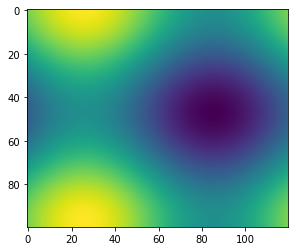

In [31]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation

fig, ax = plt.subplots()


def f(x, y):
    return np.sin(x) + np.cos(y)

x = np.linspace(0, 2 * np.pi, 120)
y = np.linspace(0, 2 * np.pi, 100).reshape(-1, 1)

# ims is a list of lists, each row is a list of artists to draw in the
# current frame; here we are just animating one artist, the image, in
# each frame
ims = []
for i in range(60):
    x += np.pi / 15.
    y += np.pi / 20.
    im = ax.imshow(f(x, y), animated=True)
    if i == 0:
        ax.imshow(f(x, y))  # show an initial one first
    ims.append([im])

ani = animation.ArtistAnimation(fig, ims, interval=50, blit=True,
                                repeat_delay=1000)

# To save the animation, use e.g.
#
# ani.save("movie.mp4")
#
# or
#
# writer = animation.FFMpegWriter(
#     fps=15, metadata=dict(artist='Me'), bitrate=1800)
# ani.save("movie.mp4", writer=writer)

plt.show()